# Gitcoin Grants 14 Sybil Detection Report

## Preparation

In [1]:
import pandas as pd
import json
import plotly.express as px
import numpy as np
import scipy.stats as st
from util import open_largest_file_in_zip
import seaborn as sns
import matplotlib.pyplot as plt

### Load Aggregate Result

In [2]:
path = '../private_data/gr14_report/csv_output_20220629-224721_csv_output.csv'
output_df = pd.read_csv(path).set_index('handle')
output_df.head(2)

,aggregate_score,prediction_score,evaluation_score,heuristic_score,create_distance,update_distance,public_repos,followers,following,bio_length,amount_in_usdt_median,amount_in_usdt_std,amount_in_usdt_std_per_count,amount_to_gitcoin_ratio,contrib_count,eth_share,token
handle,,,,,,,,,,,,,,,,,
ahazel51874,0.0,0.182424,NaN,NaN,-269.0,-269.0,1.0,0.0,0.0,0.0,1.013867,0.266036,0.019003,0.00136,14.0,0.071429,ETH
poliernase574,1.0,0.994440,NaN,NaN,12.0,12.0,0.0,0.0,0.0,0.0,1.003036,0.111277,0.008560,0.05000,13.0,0.076923,ETH


### Load Contributions

In [3]:
path = '../private_data/gr14_report/raw_data_20220629-224520_raw_data.hdf5'
contribs_df = pd.read_hdf(path, "metabase")
contribs_df.head(2)


,created_on,modified_on,profile_for_clr_id,success,wallet_address,handle,raw_amount_in_token,amount_in_token,amount_to_gitcoin_in_token,amount_in_usdt,token,ip_addr
0,2022-06-09 00:00:30.127718+00:00,2022-06-09 00:10:41.355795+00:00,264900,True,0x2c07a2ac29541b9124da12836729d6305494d6f0,hossynn,1.00,1.00,0.05,1.00,DAI,217.146.94.20
1,2022-06-09 00:00:30.995488+00:00,2022-06-09 23:14:59.593242+00:00,264900,False,0x2c07a2ac29541b9124da12836729d6305494d6f0,hossynn,0.05,0.05,0.05,0.05,DAI,217.146.94.20


### Load Human Flags

In [4]:
path = '../private_data/gr14_report/human_flags_20220629-224204_human_flags.json'
with open(path) as f:
    human_flags = json.load(f)

def eval_sheet_to_df(sheet, sheet_data):
    eval_round = sheet.split("HES_")[-1][-13:]
    evaluator = sheet.split("HES_")[0]
    eval_df = (pd.DataFrame
                 .from_dict(human_flags[sheet], orient='index')
                 .reset_index()
                 .rename(columns={'index': 'handle'})
                 .assign(sheet=sheet)
                 .assign(eval_round=eval_round)
                 .assign(evaluator=evaluator)
              )
    return eval_df


def evaluation_score_rule(d: dict) -> float:
    """
    Returns a value of [0, 1] OR **nan** for each user.
    """
    v_1 = d['is_sybil'].lower().strip()
    v_2 = d['answer_confidence'].lower().strip()

    if v_1 in {'t', 'f'} and v_2 in {'low', 'so-so', 'high'}:
        if v_1 == 't':
            if v_2 == 'low':
                return 3 / 5
            elif v_2 == 'so-so':
                return 4 / 5
            elif v_2 == 'high':
                return 5 / 5
            else:
                return 4 / 5
        else:
            if v_2 == 'low':
                return 2 / 5
            elif v_2 == 'so-so':
                return 1 / 5
            elif v_2 == 'high':
                return 0 / 5
            else:
                return 1 / 5       
    else:
        return np.nan
    
    
human_flags_df = (pd.concat([eval_sheet_to_df(sheet, sheet_data)
                             for (sheet, sheet_data)
                             in human_flags.items()])
                    .set_index(['eval_round', 'evaluator', 'handle'])
                    .assign(evaluation_score=lambda df: df.apply(evaluation_score_rule, axis=1))
                    .query("eval_round != 'Squelches'")
                 )


## Analysis

### Sybil Incidence

---
Estimated Sybil Incidence: 22.1% +/- 3.0%
High Confidence Sybil Fraction per Round


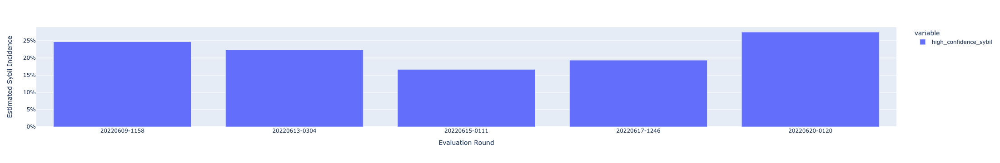

In [5]:
print("---")
df = human_flags_df.assign(high_confidence_sybil=lambda df: df.evaluation_score > 0.9)
incidence_avg = df.high_confidence_sybil.mean()
n = len(df)
p = incidence_avg
incidence_ci = (st.binom.ppf(0.975, n, p) - st.binom.ppf(0.025, n, p)) / n

print(f"Estimated Sybil Incidence: {incidence_avg :.1%} +/- {incidence_ci :.1%}")
x = df.groupby("eval_round").high_confidence_sybil.mean()
print("High Confidence Sybil Fraction per Round")
fig = px.bar(df.groupby("eval_round").high_confidence_sybil.mean(),
             labels={"value": "Estimated Sybil Incidence",
                     "eval_round": "Evaluation Round"})
fig.update_layout(yaxis_tickformat=',.0%') 
fig.show()

### Summary Statistics

##### Flagging Stats

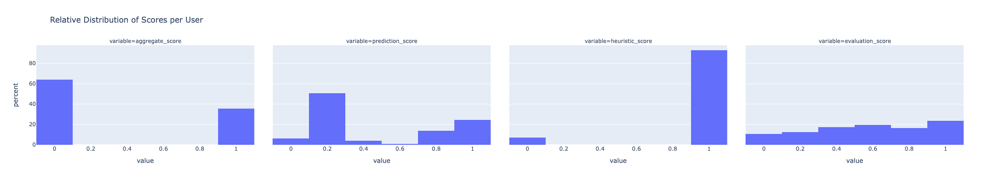

In [6]:
COLS = {'aggregate_score',
        'prediction_score',
        'heuristic_score',
        'evaluation_score'}
fig_df = output_df.reset_index().melt(id_vars=['handle'], value_vars=COLS)

fig = px.histogram(fig_df,
                   x='value',
                   histnorm='percent',
                   title='Relative Distribution of Scores per User',
                   facet_col='variable',
                   nbins=6,
                   width=1000,
                   height=400)


fig.show()

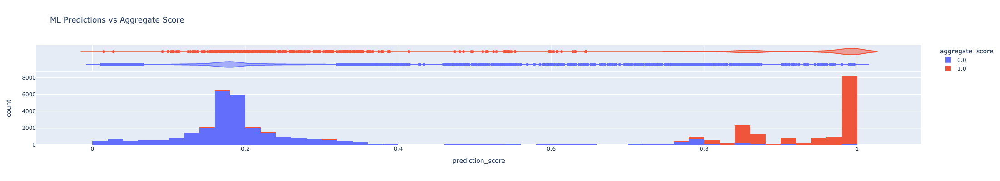

In [7]:
fig = px.histogram(output_df, 
                   'prediction_score', 
                   color='aggregate_score',
                   nbins=50,
                   title='ML Predictions vs Aggregate Score',
                   marginal='violin',
                   width=1000,
                   height=400)

fig.show()

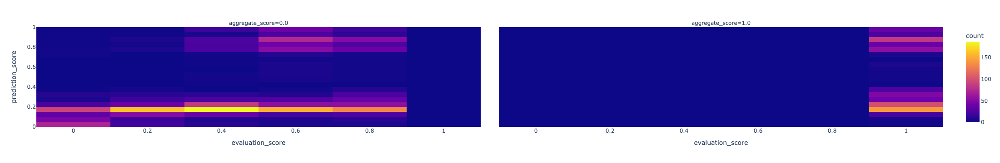

In [8]:
fig = px.density_heatmap(output_df,
                         x='evaluation_score',
                         y='prediction_score',
                         facet_col='aggregate_score',
                         nbinsx=6,
                         nbinsy=20)
fig.show()

In [9]:
EVAL_THRESHOLD = 0.9
PRED_THRESHOLD = 0.8
print("---")

cond_1 = ~pd.isnull(output_df.evaluation_score)
val_1 = (cond_1).sum()
val_2 = (cond_1).mean()
print(f"Total users evaluated by humans: {cond_1.sum()} ({cond_1.mean() :.1%} of total)")
cond_1a = output_df.loc[cond_1, 'evaluation_score'] > EVAL_THRESHOLD
cond_1b = cond_1 & (~cond_1a)
print(f"~~threshold: {EVAL_THRESHOLD}~~")
print(f"Users marked as true by humans: {cond_1a.sum()} ({cond_1a.mean() :.1%})")
print(f"Users marked as false by humans: {cond_1b.sum()} ({1 - cond_1a.mean() :.1%})")
print("---")

cond_2 = ~pd.isnull(output_df.heuristic_score)
cond_2 = cond_2 & (~cond_1)
print(f"Total users evaluated by heuristics: {cond_2.sum()} ({cond_2.mean() :.1%} of total)")
cond_2a = output_df.loc[cond_2, 'heuristic_score'] > 0.5
cond_2b = cond_2 & (~cond_2a)
print(f"Users marked as true by heuristics: {cond_2a.sum()} ({cond_2a.mean() :.1%})")
print(f"Users marked as false by heuristics: {cond_2b.sum()} ({1 - cond_2a.mean() :.1%})")
print("---")


cond_3 = ~pd.isnull(output_df.prediction_score)
cond_3 = cond_3 &(~(cond_1 | cond_2))
print(f"Total users evaluated by algorithms: {cond_3.sum()} ({cond_3.mean() :.1%} of total)")
cond_3a = output_df.loc[cond_3, 'prediction_score'] > PRED_THRESHOLD
cond_3b = cond_3 & (~cond_3a)
print(f"~~threshold: {PRED_THRESHOLD}~~")
print(f"Users marked as true by algorithms: {cond_3a.sum()} ({cond_3a.mean() :.1%})")
print(f"Users marked as false by algorithms: {cond_3b.sum()} ({1 - cond_3a.mean() :.1%})")
print("---")

cond_4 = ~pd.isnull(output_df.aggregate_score)
print(f"Total users evaluated: {cond_4.sum()} ({cond_4.mean() :.1%} of total)")
cond_4a = output_df.loc[cond_4, 'aggregate_score'] > 0.5
cond_4b = cond_4 & (~cond_4a)
print(f"Users marked as true: {cond_4a.sum()} ({cond_4a.mean() :.1%})")
print(f"Users marked as false: {cond_4b.sum()} ({1 - cond_4a.mean() :.1%})")
print("---")

---
Total users evaluated by humans: 2729 (6.1% of total)
~~threshold: 0.9~~
Users marked as true by humans: 641 (23.5%)
Users marked as false by humans: 2088 (76.5%)
---
Total users evaluated by heuristics: 6519 (14.5% of total)
Users marked as true by heuristics: 6074 (93.2%)
Users marked as false by heuristics: 445 (6.8%)
---
Total users evaluated by algorithms: 35638 (79.4% of total)
~~threshold: 0.8~~
Users marked as true by algorithms: 9358 (26.3%)
Users marked as false by algorithms: 26280 (73.7%)
---
Total users evaluated: 44886 (100.0% of total)
Users marked as true: 16073 (35.8%)
Users marked as false: 28813 (64.2%)
---


#### Sybil Impact

Total Contributions (original): 623400
Total Contributions (modified): 623400
Total Contributions (removed): 167988
___
Matched Contributions (original): 623400
Matched Contributions (modified): 455412
Matched Contributions (removed): 0
Change: 167988
Total Contributors (original): 44870
Total Contributors (modified): 28814
Total Contributors (removed): 16057
---
Sum of USDT Amount (original): 3507425.77
Sum of USDT Amount (removed): 879342.51
---
Median of Median USDT Amount per User (original): 1.14
Median of Median USDT Amount per User (modified): 1.20
Median of Median USDT Amount per User (removed): 1.10
---
Median Contribution Count per User (original): 8.00
Median Contribution Count per User (modified): 9.00
Median Contribution Count per User (removed): 6.00
---
Mean Count per User (original): 13.89
Mean Count per User (modified): 21.64
Mean Count per User (removed): 10.46
---


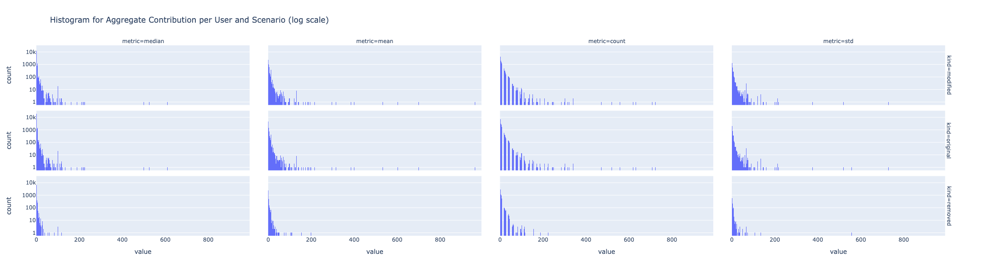

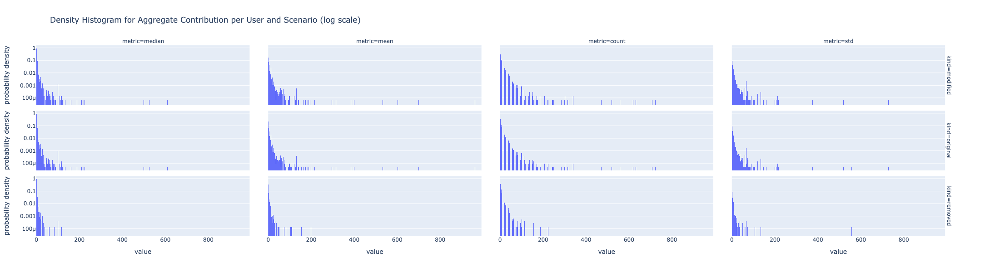

In [10]:
df = (contribs_df.assign(is_sybil=contribs_df.handle.map(cond_4a))
                 .dropna(subset=['is_sybil'])
                 .assign(kind='original')
                 .assign(match='t')
     )
SYBIL_HANDLE = 'SYBIL'

def f(d):
    d.loc[d.is_sybil, 'handle'] = SYBIL_HANDLE
    return d

modified_df = (df.copy()
                 .pipe(f)
                 .assign(kind='modified'))

# Key Assumption: set all sybil contributions as not-matching
modified_df.loc[modified_df.is_sybil.astype(bool), 'match'] = 'f'
modified_df.loc[~modified_df.is_sybil.astype(bool), 'match'] = 't'

removed_df = (df.copy()
                 .loc[modified_df.is_sybil, :]
                 .assign(kind='removed')
                 .assign(match='f'))

scenarios_df = pd.concat([df, modified_df, removed_df])
# Total Contributions

print(f"Total Contributions (original): {len(df)}")
print(f"Total Contributions (modified): {len(modified_df)}")
print(f"Total Contributions (removed): {len(removed_df)}")
print("___")
print(f"Matched Contributions (original): {sum(df.match == 't')}")
print(f"Matched Contributions (modified): {sum(modified_df.match == 't')}")
print(f"Matched Contributions (removed): {sum(removed_df.match == 't')}")

print(f"Change: {sum(df.match == 't') - sum(modified_df.match == 't')}")

# Some summary stats

GROUP_KEY = 'handle'

group_original = df.groupby(GROUP_KEY)
group_modified = modified_df.groupby(GROUP_KEY)
group_removed = removed_df.groupby(GROUP_KEY)


print(f"Total Contributors (original): {len(df.handle.unique())}")
print(f"Total Contributors (modified): {len(modified_df.handle.unique())}")
print(f"Total Contributors (removed): {len(removed_df.handle.unique())}")
print("---")

print(f"Sum of USDT Amount (original): {group_original.amount_in_usdt.sum().sum() :.2f}")
print(f"Sum of USDT Amount (removed): {group_removed.amount_in_usdt.sum().sum() :.2f}")
print("---")

print(f"Median of Median USDT Amount per User (original): {group_original.amount_in_usdt.median().median() :.2f}")
print(f"Median of Median USDT Amount per User (modified): {group_modified.amount_in_usdt.median().median() :.2f}")
print(f"Median of Median USDT Amount per User (removed): {group_removed.amount_in_usdt.median().median() :.2f}")
print("---")

print(f"Median Contribution Count per User (original): {group_original.amount_in_usdt.count().median() :.2f}")
print(f"Median Contribution Count per User (modified): {group_modified.amount_in_usdt.count().median() :.2f}")
print(f"Median Contribution Count per User (removed): {group_removed.amount_in_usdt.count().median() :.2f}")

print("---")

print(f"Mean Count per User (original): {group_original.amount_in_usdt.count().mean() :.2f}")
print(f"Mean Count per User (modified): {group_modified.amount_in_usdt.count().mean() :.2f}")
print(f"Mean Count per User (removed): {group_removed.amount_in_usdt.count().mean() :.2f}")
print("---")

COLS = {'amount_in_usdt', 'kind', 'handle'}
grouper = scenarios_df.loc[:, COLS].groupby(['kind', 'handle'])

fig_df = (grouper.agg(['median', 'mean', 'count', 'std'])
                 .dropna()
                 .amount_in_usdt
                 .stack()
                 .reset_index()
                 .rename(columns={'level_2': 'metric', 0: 'value'})
                 .query('value < 1_000'))

fig = px.histogram(fig_df,
                   x='value',
                   facet_row='kind',
                   facet_col='metric',
                   log_y=True,
                   title='Histogram for Aggregate Contribution per User and Scenario (log scale)',
                   height=600,
                   width=1000)

fig_2 = px.histogram(fig_df,
                   x='value',
                   facet_row='kind',
                   facet_col='metric',
                   log_y=True,
                   title='Density Histogram for Aggregate Contribution per User and Scenario (log scale)',
                   histnorm='probability density', 
                   height=600,
                   width=1000)

fig.show()
fig_2.show()

In [11]:
total_contributors = len(df.handle.unique())
print(f"Total Contributors (original): {total_contributors}")
flagged_users = cond_4a.sum()
flagged_fraction = flagged_users / total_contributors
estimated_sybil_users = total_contributors * incidence_avg
esu_max = total_contributors * (incidence_avg + incidence_ci)
esu_min = total_contributors * (incidence_avg - incidence_ci)
estimated_flagging = flagged_users / estimated_sybil_users
ef_max = flagged_users / esu_max
ef_min = flagged_users / esu_min
print("---")
print(f"Estimated Sybil Incidence: {incidence_avg :.1%} +/- {incidence_ci :.1%}")
print(f"Estimated # of Sybil Users: {round(estimated_sybil_users)} (between {round(esu_min)} and {round(esu_max)})")
print(f"Number of Flagged Users: {flagged_users} ({flagged_fraction :.1%})")
print(f"Users marked as true by humans: {cond_1a.sum()}")
print(f"Users marked as true by heuristics: {cond_2a.sum()}")
print(f"Users marked as true by algorithms: {cond_3a.sum()}")
print(f"Total Contributions (removed): {len(removed_df)}")
print(f"Estimated Flagging Per Incidence: {estimated_flagging :.1%} (between {ef_max :.1%} and {ef_min :.1%})")

Total Contributors (original): 44870
---
Estimated Sybil Incidence: 22.1% +/- 3.0%
Estimated # of Sybil Users: 9916 (between 8585 and 11247)
Number of Flagged Users: 16073 (35.8%)
Users marked as true by humans: 641
Users marked as true by heuristics: 6074
Users marked as true by algorithms: 9358
Total Contributions (removed): 167988
Estimated Flagging Per Incidence: 162.1% (between 142.9% and 187.2%)
